In [358]:
import pandas as pd
import numpy as np

# import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import json 


import re


import statistics








In [359]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

# Load the Dataset

In [360]:
df = pandas = pd.read_csv('../German_Credit_data/Data/german.data', sep=' ')
df

,A11,6,A34,A43,1169,A65,A75,4,A93,A101,...,A121,67,A143,A152,2,A173,1,A192,A201,1.1
0,A12,48,A32,A43,5951,A61,A73,2,A92,A101,...,A121,22,A143,A152,1,A173,1,A191,A201,2
1,A14,12,A34,A46,2096,A61,A74,2,A93,A101,...,A121,49,A143,A152,1,A172,2,A191,A201,1
2,A11,42,A32,A42,7882,A61,A74,2,A93,A103,...,A122,45,A143,A153,1,A173,2,A191,A201,1
3,A11,24,A33,A40,4870,A61,A73,3,A93,A101,...,A124,53,A143,A153,2,A173,2,A191,A201,2
4,A14,36,A32,A46,9055,A65,A73,2,A93,A101,...,A124,35,A143,A153,1,A172,2,A192,A201,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,A14,12,A32,A42,1736,A61,A74,3,A92,A101,...,A121,31,A143,A152,1,A172,1,A191,A201,1
995,A11,30,A32,A41,3857,A61,A73,4,A91,A101,...,A122,40,A143,A152,1,A174,1,A192,A201,1
996,A14,12,A32,A43,804,A61,A75,4,A93,A101,...,A123,38,A143,A152,1,A173,1,A191,A201,1
997,A11,45,A32,A43,1845,A61,A73,4,A93,A101,...,A124,23,A143,A153,1,A173,1,A192,A201,2


# Da die Attributsnamen kodiert sind werden diese zu erst mithilfe der zugehörigen Dokumentation ersetzt. (Siehe Categorical.json)


In [361]:
file_path = "../German_Credit_data/Data/german.data"

names = ['Status Checking', 'Duration in Month', 'Credit History', 'Purpose', 'Credit Amount', 
         'Savings Account', 'Employement since', 'Installmentrate %', 'StatusSex', 'Other debtors', 
         'PresentResidence', 'Property', 'Age in years', 'Otherinstallment Plans', 'Housing', 
         'Number existing Credits', 'Job', 'Number people liable', 'Telephone', 'Foreign Worker', 'Target']
german_data = pd.read_csv(file_path,names=names,delim_whitespace=True, header=None)
catgories = open('../German_Credit_data/Data/categorical.json')
json_data = json.load(catgories)
json_data
for h in names:
    if h in json_data:
        german_data[h] = german_data[h].map(json_data[h])

In [362]:
german_data.head(10)

,Status Checking,Duration in Month,Credit History,Purpose,Credit Amount,Savings Account,Employement since,Installmentrate %,StatusSex,Other debtors,...,Property,Age in years,Otherinstallment Plans,Housing,Number existing Credits,Job,Number people liable,Telephone,Foreign Worker,Target
0,less than 0 DM,6,critical account / other credits existing (not...,radio/television,1169,unknown / no savings account,bigger than or equal 7 years,4,male : single,None,...,real estate,67,None,own,2,skilled employee /official,1,"yes, registered under the customers name",yes,1
1,0 less than or equal and less than 200 DM,48,existing credits paind back duly till now,radio/television,5951,less than 100DM,1 less than or equal and less than 4 years,2,female : divorced/separated/married,None,...,real estate,22,None,own,1,skilled employee /official,1,None,yes,2
2,no checking account,12,critical account / other credits existing (not...,education,2096,less than 100DM,4 less than and equal and less than 7 years,2,male : single,None,...,real estate,49,None,own,1,unskilled-resident,2,None,yes,1
3,less than 0 DM,42,existing credits paind back duly till now,furniture/equipment,7882,less than 100DM,4 less than and equal and less than 7 years,2,male : single,guarantor,...,if not real estate : building society savings ...,45,None,for free,1,skilled employee /official,2,None,yes,1
4,less than 0 DM,24,delay in paying off in the past,car (new),4870,less than 100DM,1 less than or equal and less than 4 years,3,male : single,None,...,unknown/no property,53,None,for free,2,skilled employee /official,2,None,yes,2
5,no checking account,36,existing credits paind back duly till now,education,9055,unknown / no savings account,1 less than or equal and less than 4 years,2,male : single,None,...,unknown/no property,35,None,for free,1,unskilled-resident,2,"yes, registered under the customers name",yes,1
6,no checking account,24,existing credits paind back duly till now,furniture/equipment,2835,500 less than or equal and 1000 DM,bigger than or equal 7 years,3,male : single,None,...,if not real estate : building society savings ...,53,None,own,1,skilled employee /official,1,None,yes,1
7,0 less than or equal and less than 200 DM,36,existing credits paind back duly till now,car (used),6948,less than 100DM,1 less than or equal and less than 4 years,2,male : single,None,...,"if not others options : car or other, not in s...",35,None,rent,1,management/self-employed/highly qualified empl...,1,"yes, registered under the customers name",yes,1
8,no checking account,12,existing credits paind back duly till now,radio/television,3059,bigger than or equal 1000 DM,4 less than and equal and less than 7 years,2,male : divorced/separated,None,...,real estate,61,None,own,1,unskilled-resident,1,None,yes,1
9,0 less than or equal and less than 200 DM,30,critical account / other credits existing (not...,car (new),5234,less than 100DM,unemployed,4,male : married/windowed,None,...,"if not others options : car or other, not in s...",28,None,own,2,management/self-employed/highly qualified empl...,1,None,yes,2


In [363]:
# Statistische Daten zur Datenanalyse
german_data.describe()

,Duration in Month,Credit Amount,Installmentrate %,PresentResidence,Age in years,Number existing Credits,Number people liable,Target
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,20.903000,3271.258000,2.973000,2.845000,35.546000,1.407000,1.155000,1.300000
std,12.058814,2822.736876,1.118715,1.103718,11.375469,0.577654,0.362086,0.458487
min,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,1.000000,1.000000
25%,12.000000,1365.500000,2.000000,2.000000,27.000000,1.000000,1.000000,1.000000
50%,18.000000,2319.500000,3.000000,3.000000,33.000000,1.000000,1.000000,1.000000
75%,24.000000,3972.250000,4.000000,4.000000,42.000000,2.000000,1.000000,2.000000
max,72.000000,18424.000000,4.000000,4.000000,75.000000,4.000000,2.000000,2.000000


In [364]:
german_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Status Checking          1000 non-null   object
 1   Duration in Month        1000 non-null   int64 
 2   Credit History           1000 non-null   object
 3   Purpose                  1000 non-null   object
 4   Credit Amount            1000 non-null   int64 
 5   Savings Account          1000 non-null   object
 6   Employement since        1000 non-null   object
 7   Installmentrate %        1000 non-null   int64 
 8   StatusSex                1000 non-null   object
 9   Other debtors            1000 non-null   object
 10  PresentResidence         1000 non-null   int64 
 11  Property                 1000 non-null   object
 12  Age in years             1000 non-null   int64 
 13  Otherinstallment Plans   1000 non-null   object
 14  Housing                  1000 non-null   

In [365]:
# check for missing values
german_data.isnull().sum()


Status Checking            0
Duration in Month          0
Credit History             0
Purpose                    0
Credit Amount              0
Savings Account            0
Employement since          0
Installmentrate %          0
StatusSex                  0
Other debtors              0
PresentResidence           0
Property                   0
Age in years               0
Otherinstallment Plans     0
Housing                    0
Number existing Credits    0
Job                        0
Number people liable       0
Telephone                  0
Foreign Worker             0
Target                     0
dtype: int64

# Prüfung der Daten auf Plausibilität und Allgemeine Datenanalyse

<AxesSubplot:>

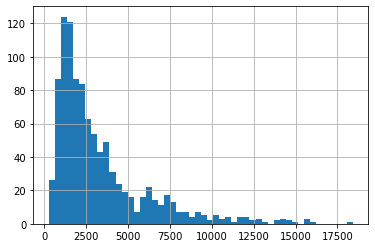

In [366]:
#check credit amount for outliers
german_data['Credit Amount'].hist(bins=50)




<AxesSubplot:ylabel='Frequency'>

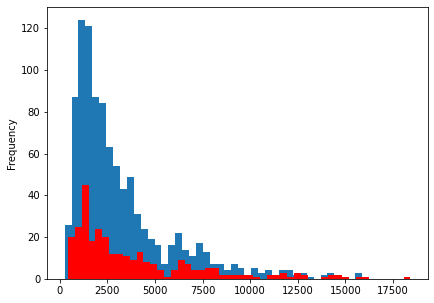

In [367]:
plt.subplot(1, 2, 1)
german_data['Credit Amount'].plot(kind='hist', logx=False, bins=50)
# plot histogram credit amout where target is 2
german_data.loc[german_data['Target'] == 2, 'Credit Amount'].plot(kind='hist', logx=False, bins=50, color='red', figsize=(15, 5))


<AxesSubplot:ylabel='Target'>

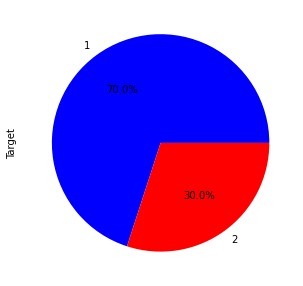

In [368]:
# plot target variable as pie chart with target 1 and target 2 as labels colored red and blue

german_data['Target'].value_counts().plot(kind='pie', colors=['blue', 'red'], autopct='%1.1f%%', figsize=(15, 5))

<AxesSubplot:>

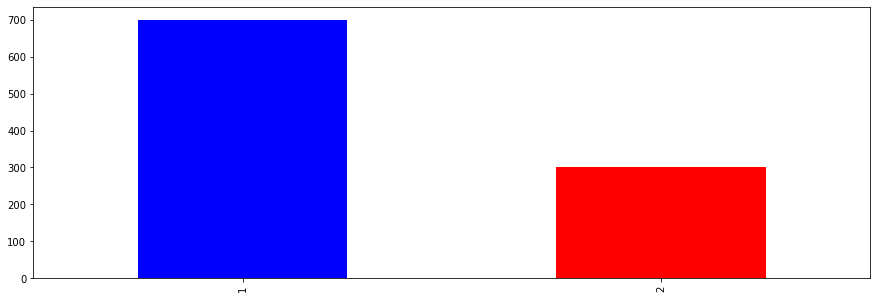

In [369]:
# plot distribution of target variable with color 2 as red and color 1 as blue
german_data['Target'].value_counts().plot(kind='bar', figsize=(15, 5), color=['blue', 'red'])

<AxesSubplot:xlabel='Duration in Month', ylabel='Count'>

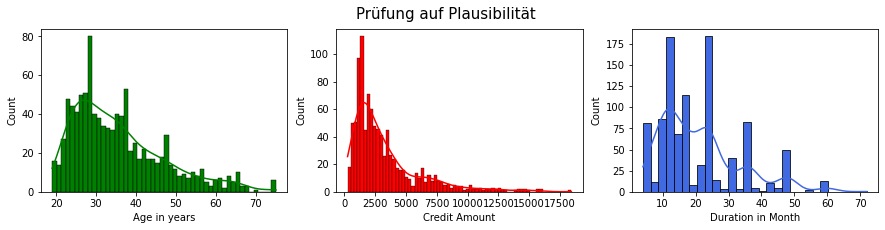

In [370]:
##subplot of numeric features
fig, axes = plt.subplots(1, 3, figsize=(15, 3), sharey=False)
fig.suptitle('Prüfung auf Plausibilität', size=15)

##Credit Amount distribution
sns.histplot(data=german_data,ax=axes[1], x="Credit Amount", kde=True, color='red', bins=70,alpha=1)

##Age distribution
sns.histplot(data=german_data, ax=axes[0],x="Age in years", kde=True, color='green', bins=50,alpha=1)

##Credit Duration distribution
sns.histplot(data=german_data, ax=axes[2],x="Duration in Month", kde=True, color='royalblue',alpha=1)

Log Verteilung

<AxesSubplot:xlabel='Duration in Month', ylabel='Credit Amount'>

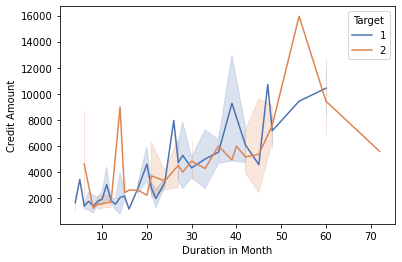

In [371]:
# Relationship between credit amount and duration of the loan
sns.lineplot(data=german_data, x='Duration in Month', y='Credit Amount', hue='Target', palette='deep')

Der Plot zeigt einen linearen Zusammenhang zwischen Kreditlaufzeit und Kredithöhe

# Zielvariable ist Ungleichverteilt

# Untersuchung auf Outlier

<AxesSubplot:title={'center':'Credit Amount'}, xlabel='Target'>

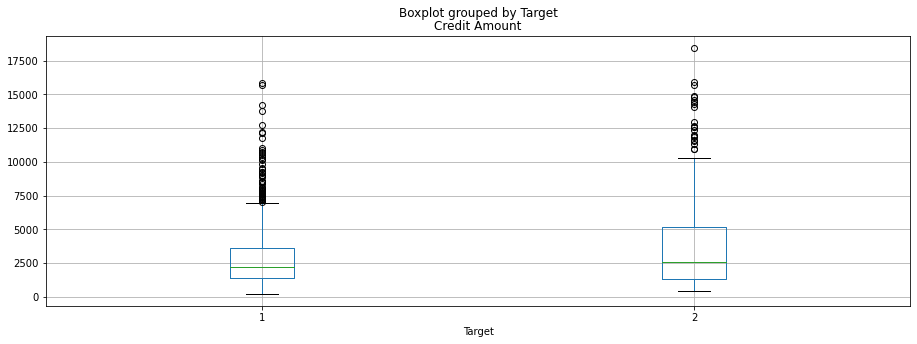

In [372]:
#box plot credit amount outliers
german_data.boxplot(column='Credit Amount', by='Target', figsize=(15, 5))

Anträge mit höheren Kreditsummen sind häufiger als Risikoreich klassifiziert

<AxesSubplot:xlabel='Credit Amount', ylabel='Target'>

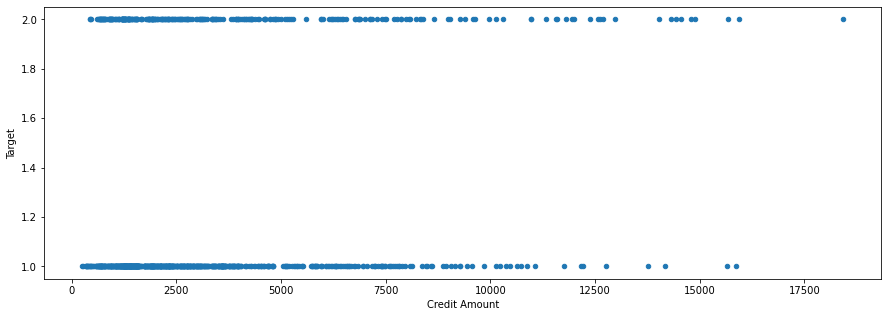

In [373]:
# scatter plot credit amount
german_data.plot(kind='scatter', x='Credit Amount', y='Target', figsize=(15, 5))

## Outlier Analysis
Um zu bewerten, ob der Datensatz ein bestimmtes maß an Außreißern beinhaltet wird der Z-Score verwendet

<AxesSubplot:ylabel='Frequency'>

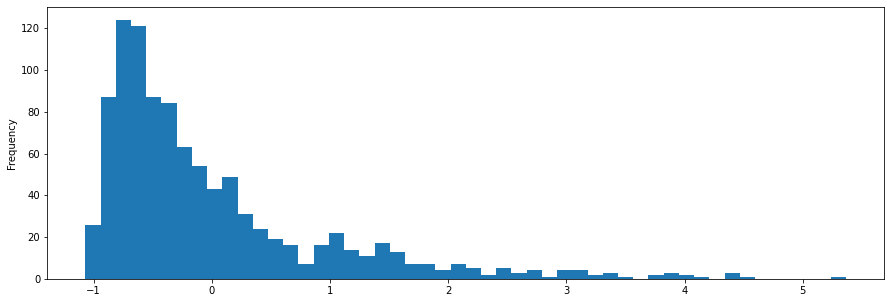

In [374]:
# calculate ZScore for credit amount --> for outlier detection
german_data['ZScore'] = (german_data['Credit Amount'] - german_data['Credit Amount'].mean()) / german_data['Credit Amount'].std()
#plot zscore for credit amount
german_data['ZScore'].plot(kind='hist', bins=50, figsize=(15, 5))

In [375]:
# calculate IQR for credit amount
def outlier_detection(df):
    Q1 = np.percentile(german_data['Credit Amount'], 25,
                    interpolation = 'midpoint')
    
    Q3 = np.percentile(german_data['Credit Amount'], 75,
                    interpolation = 'midpoint')
    IQR = Q3 - Q1

    upper = Q3 +1.5*IQR
    lower = Q1 - 1.5*IQR
    upper = german_data['Credit Amount'] >= (Q3+1.5*IQR)
    
    print("Upper bound:",upper)
    print(np.where(upper))
    
    # Below Lower bound
    lower = german_data['Credit Amount'] <= (Q1-1.5*IQR)
    print("Lower bound:", lower)
    print(np.where(lower))
outlier_detection(german_data)

# remove outliers from credit amount based on zscore
#german_data = german_data.loc[(german_data['ZScore'] < 3) & (german_data['ZScore'] > -3)]


Upper bound: 0      False
1      False
2      False
3      False
4      False
       ...  
995    False
996    False
997    False
998    False
999    False
Name: Credit Amount, Length: 1000, dtype: bool
(array([  5,  17,  18,  57,  63,  70,  78,  87,  95, 105, 130, 134, 136,
       180, 205, 226, 236, 268, 272, 274, 285, 291, 295, 304, 333, 373,
       374, 378, 381, 395, 402, 417, 431, 450, 491, 496, 509, 525, 549,
       563, 615, 616, 637, 645, 653, 657, 672, 684, 714, 736, 744, 763,
       771, 805, 808, 812, 818, 828, 832, 854, 881, 887, 895, 902, 915,
       917, 921, 927, 945, 953, 980, 983], dtype=int64),)
Lower bound: 0      False
1      False
2      False
3      False
4      False
       ...  
995    False
996    False
997    False
998    False
999    False
Name: Credit Amount, Length: 1000, dtype: bool
(array([], dtype=int64),)


In [376]:
german_data

,Status Checking,Duration in Month,Credit History,Purpose,Credit Amount,Savings Account,Employement since,Installmentrate %,StatusSex,Other debtors,...,Age in years,Otherinstallment Plans,Housing,Number existing Credits,Job,Number people liable,Telephone,Foreign Worker,Target,ZScore
0,less than 0 DM,6,critical account / other credits existing (not...,radio/television,1169,unknown / no savings account,bigger than or equal 7 years,4,male : single,None,...,67,None,own,2,skilled employee /official,1,"yes, registered under the customers name",yes,1,-0.744759
1,0 less than or equal and less than 200 DM,48,existing credits paind back duly till now,radio/television,5951,less than 100DM,1 less than or equal and less than 4 years,2,female : divorced/separated/married,None,...,22,None,own,1,skilled employee /official,1,None,yes,2,0.949342
2,no checking account,12,critical account / other credits existing (not...,education,2096,less than 100DM,4 less than and equal and less than 7 years,2,male : single,None,...,49,None,own,1,unskilled-resident,2,None,yes,1,-0.416354
3,less than 0 DM,42,existing credits paind back duly till now,furniture/equipment,7882,less than 100DM,4 less than and equal and less than 7 years,2,male : single,guarantor,...,45,None,for free,1,skilled employee /official,2,None,yes,1,1.633430
4,less than 0 DM,24,delay in paying off in the past,car (new),4870,less than 100DM,1 less than or equal and less than 4 years,3,male : single,None,...,53,None,for free,2,skilled employee /official,2,None,yes,2,0.566380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,no checking account,12,existing credits paind back duly till now,furniture/equipment,1736,less than 100DM,4 less than and equal and less than 7 years,3,female : divorced/separated/married,None,...,31,None,own,1,unskilled-resident,1,None,yes,1,-0.543890
996,less than 0 DM,30,existing credits paind back duly till now,car (used),3857,less than 100DM,1 less than or equal and less than 4 years,4,male : divorced/separated,None,...,40,None,own,1,management/self-employed/highly qualified empl...,1,"yes, registered under the customers name",yes,1,0.207509
997,no checking account,12,existing credits paind back duly till now,radio/television,804,less than 100DM,bigger than or equal 7 years,4,male : single,None,...,38,None,own,1,skilled employee /official,1,None,yes,1,-0.874066
998,less than 0 DM,45,existing credits paind back duly till now,radio/television,1845,less than 100DM,1 less than or equal and less than 4 years,4,male : single,None,...,23,None,for free,1,skilled employee /official,1,"yes, registered under the customers name",yes,2,-0.505275


In [377]:
# function to determine outlier values
def outlier_iqr(df):
    quartile_1, quartile_3 = np.percentile(df, [25, 75])
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - (iqr * 1.5)
    upper_bound = quartile_3 + (iqr * 1.5)
    return np.where((df > upper_bound) | (df < lower_bound))
# calculate the outlier values


In [378]:
outlier_iqr(german_data['Credit Amount'])

(array([  5,  17,  18,  57,  63,  70,  78,  87,  95, 105, 130, 134, 136,
        180, 205, 226, 236, 268, 272, 274, 285, 291, 295, 304, 333, 373,
        374, 378, 381, 395, 402, 417, 431, 450, 491, 496, 509, 525, 549,
        563, 615, 616, 637, 645, 653, 657, 672, 684, 714, 736, 744, 763,
        771, 805, 808, 812, 818, 828, 832, 854, 881, 887, 895, 902, 915,
        917, 921, 927, 945, 953, 980, 983], dtype=int64),)

In [379]:
outlier_iqr(german_data['Age in years'])

(array([  0,  75, 137, 163, 179, 186, 187, 213, 330, 430, 438, 536, 554,
        606, 624, 723, 756, 774, 779, 807, 846, 883, 917], dtype=int64),)

# Datenanalyse

In [380]:
# transform target value 2 to 1 and 1 to 0 to be binary
# 0 = good credit ; 1 = bad credit
german_data['Target'] = german_data['Target'].map({2:1, 1:0})





In [381]:
german_data['Target'].value_counts()

0    700
1    300
Name: Target, dtype: int64

In [382]:
german_data.head()

,Status Checking,Duration in Month,Credit History,Purpose,Credit Amount,Savings Account,Employement since,Installmentrate %,StatusSex,Other debtors,...,Age in years,Otherinstallment Plans,Housing,Number existing Credits,Job,Number people liable,Telephone,Foreign Worker,Target,ZScore
0,less than 0 DM,6,critical account / other credits existing (not...,radio/television,1169,unknown / no savings account,bigger than or equal 7 years,4,male : single,None,...,67,None,own,2,skilled employee /official,1,"yes, registered under the customers name",yes,0,-0.744759
1,0 less than or equal and less than 200 DM,48,existing credits paind back duly till now,radio/television,5951,less than 100DM,1 less than or equal and less than 4 years,2,female : divorced/separated/married,None,...,22,None,own,1,skilled employee /official,1,None,yes,1,0.949342
2,no checking account,12,critical account / other credits existing (not...,education,2096,less than 100DM,4 less than and equal and less than 7 years,2,male : single,None,...,49,None,own,1,unskilled-resident,2,None,yes,0,-0.416354
3,less than 0 DM,42,existing credits paind back duly till now,furniture/equipment,7882,less than 100DM,4 less than and equal and less than 7 years,2,male : single,guarantor,...,45,None,for free,1,skilled employee /official,2,None,yes,0,1.633430
4,less than 0 DM,24,delay in paying off in the past,car (new),4870,less than 100DM,1 less than or equal and less than 4 years,3,male : single,None,...,53,None,for free,2,skilled employee /official,2,None,yes,1,0.566380


In [383]:
# drop column ZScore
german_data.drop(['ZScore'], axis=1, inplace=True)

Im folgenden wird eine Korrelationsanalyse durchgeführt. 
Von den vorangegangen Analysen auf Plausibilitäte sollten einige Beobachtungen hier bestätigt werden

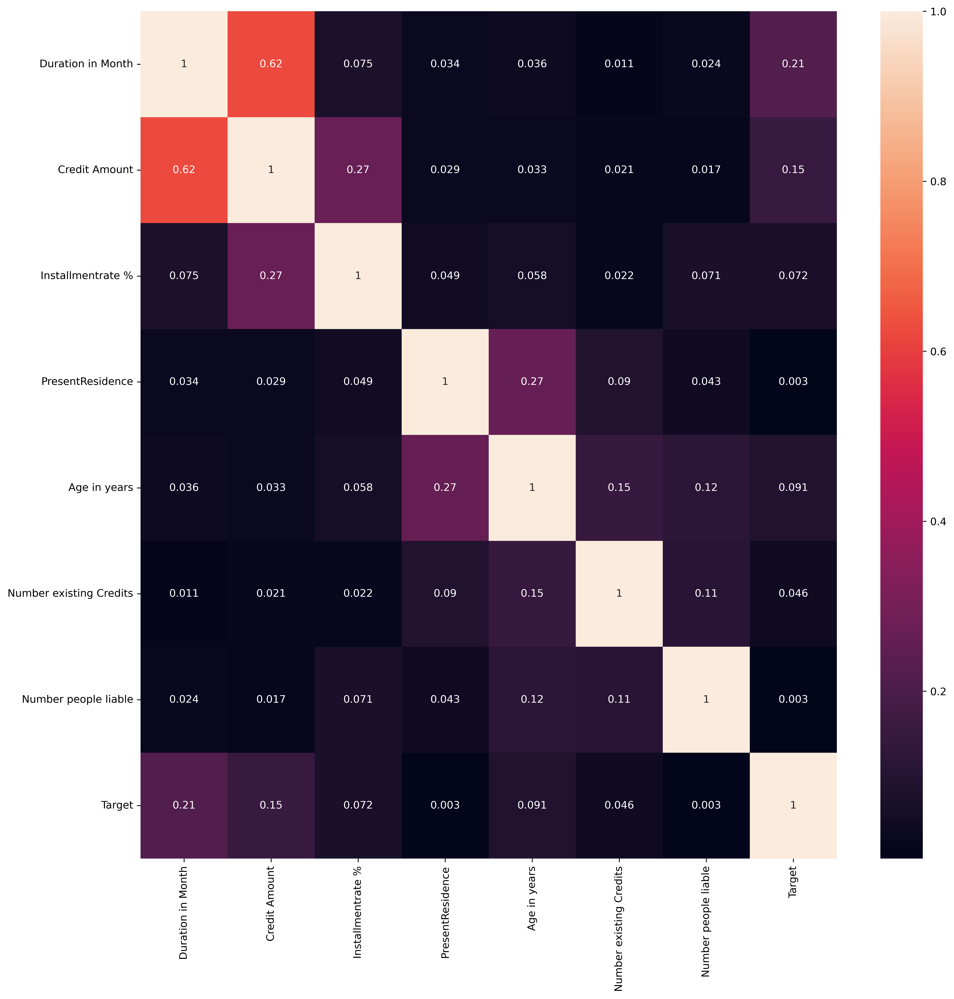

 Positive Correlations:
 Age in years              -0.091127
Number existing Credits   -0.045732
Number people liable      -0.003015
PresentResidence           0.002967
Installmentrate %          0.072404
Credit Amount              0.154739
Duration in Month          0.214927
Target                     1.000000
Name: Target, dtype: float64
 Negative Correlations:
 Age in years              -0.091127
Number existing Credits   -0.045732
Number people liable      -0.003015
PresentResidence           0.002967
Installmentrate %          0.072404
Credit Amount              0.154739
Duration in Month          0.214927
Target                     1.000000
Name: Target, dtype: float64
Credit Amount            Duration in Month          0.624984
Duration in Month        Credit Amount              0.624984
Credit Amount            Installmentrate %          0.271316
Installmentrate %        Credit Amount              0.271316
PresentResidence         Age in years               0.266419
Age in year

In [384]:
# function to calculate correlation between target and feautures 
# only plot the 5 most correlated features with target variable

def correlation_matrix(df, drop= None):
    corr_matrix = df.corr().abs()
    plt.figure(figsize=(15,15), dpi = 480)
    sns.heatmap(corr_matrix, annot=True)
    plt.show()

    correlations = df.corr()['Target'].sort_values()

    # Display correlations
    print(' Positive Correlations:\n', correlations)
    print(' Negative Correlations:\n', correlations)
    plt.figure(figsize=(25,25), dpi = 480)
    df.corr()['Target'].sort_values(ascending = False).plot(kind='bar')

    corr_unstacked = corr_matrix.unstack().abs()
    ranked_corr = corr_unstacked.sort_values(kind="quicksort", ascending=False)
    ranked_corr = ranked_corr[ranked_corr != 1]

    print(ranked_corr)
    
    # feautures die stark miteinander correlieren entfernen
    if drop is not None:
        col_corr = set()
        for i in range(len(corr_matrix.columns)):
            for j in range(i):
                if (corr_matrix.iloc[i, j] >= 0.7) and (corr_matrix.columns[j] not in col_corr):
                    colname = corr_matrix.columns[i] # getting the name of column
                    col_corr.add(colname)
                    if colname in german_data.columns:
                        del german_data[colname] # deleting the column from the dataset
correlation_matrix(german_data)

Die Ergebnisse der Korrelationsanalyse bestätigen dass die Kredithöhe linear mit der Kreditlaufzeit korreliert.

In [385]:
#iterate through feautures and get datatype and check if they are categorical or numerical and store them into list for one hot encoding

categorical_features = []
numerical_features = []
for i in german_data.columns:
    #print(i, german_data[i].dtype)
    if german_data[i].dtype == 'object':
        #print(i, german_data[i].dtype)
        categorical_features.append(i)
    else:
        #print(i, german_data[i].dtype)
        numerical_features.append(i)


print("Categorical:" ,categorical_features, "Numerical:" ,numerical_features)

Categorical: ['Status Checking', 'Credit History', 'Purpose', 'Savings Account', 'Employement since', 'StatusSex', 'Other debtors', 'Property', 'Otherinstallment Plans', 'Housing', 'Job', 'Telephone', 'Foreign Worker'] Numerical: ['Duration in Month', 'Credit Amount', 'Installmentrate %', 'PresentResidence', 'Age in years', 'Number existing Credits', 'Number people liable', 'Target']


### Stark Korrelation zwischen Credit Amount und Duration in Month --> Macht Sinn, da größere Kredite in der Regel längere Laufzeiten haben

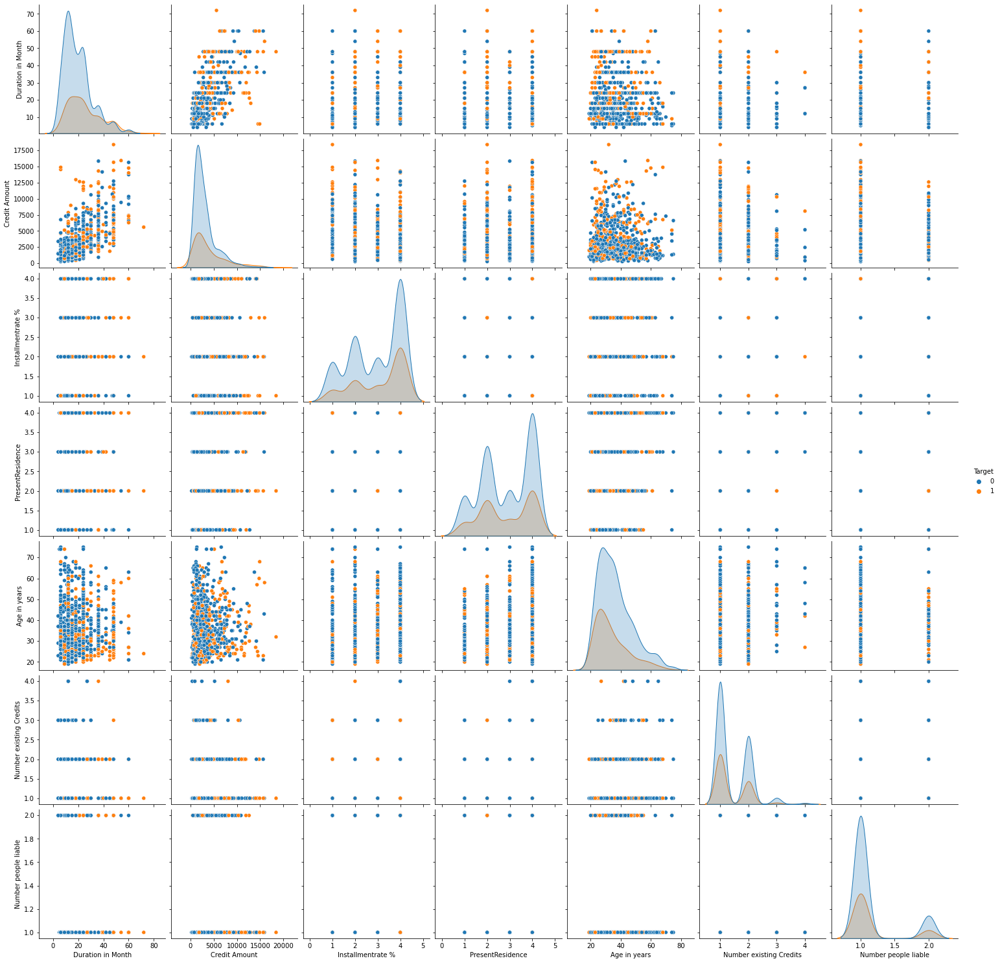

In [386]:
# pairplot um einen überblick über die Verteilung zu bekommen
sns.pairplot(german_data, hue='Target', size=3)


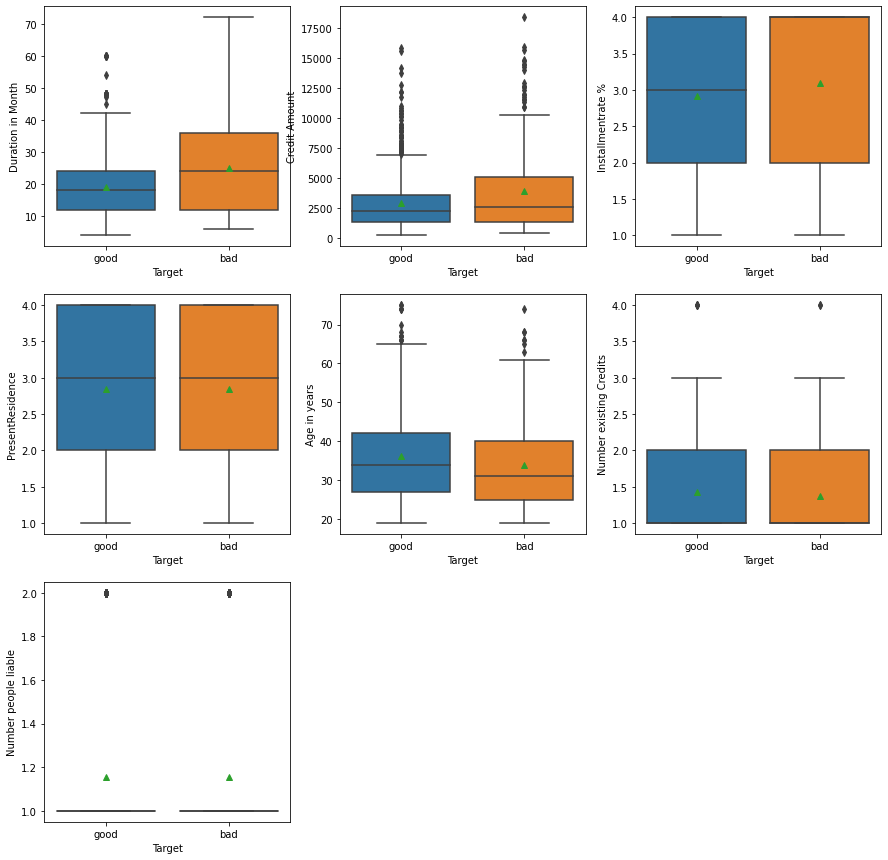

In [387]:
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

i = 0
j = 0

for category in numerical_features:
    sns.boxplot(y=german_data[category], x=german_data["Target"].replace({0:"good", 1:"bad"}), ax=axs[i, j], orient="v", showmeans=True)
    j += 1
    if j%3 == 0:
        j = 0
        i += 1
        
axs[2, 1].set_visible(True)
fig.delaxes(axs[2, 1])
axs[2, 2].set_visible(True)
fig.delaxes(axs[2, 2])

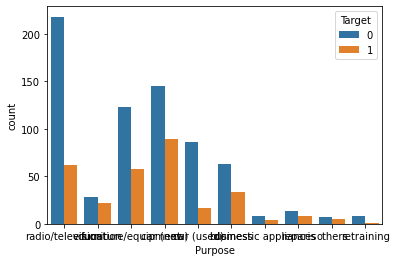

In [388]:
# functio to plot plotbar for categorical features 
def plot_bar(df, feature):
    sns.countplot(x=feature, data=df, hue='Target')
    plt.show()

plot_bar(german_data, 'Purpose')

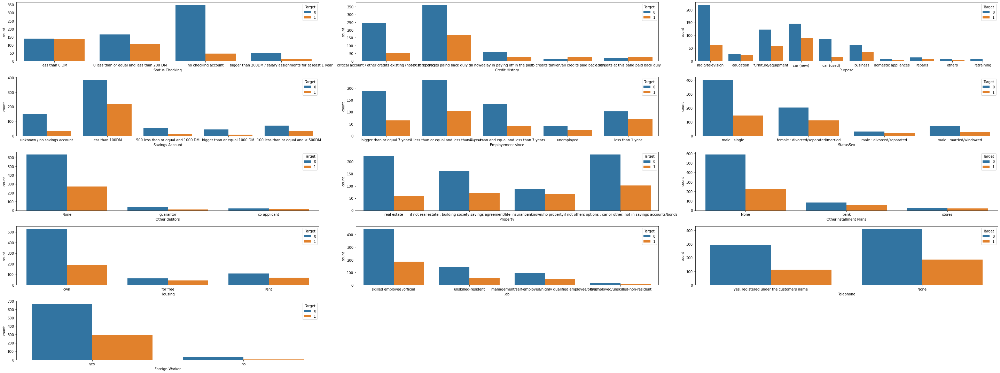

In [389]:
plt.figure(figsize=(40, 15))
for i in range(0, len(categorical_features)):
    plt.subplot(5, 3, i+1)
    sns.countplot(x = german_data[categorical_features[i]], orient='v', hue=german_data['Target'])
    plt.tight_layout()

Text(0.5, 1.0, 'Number of Customers by their duration')

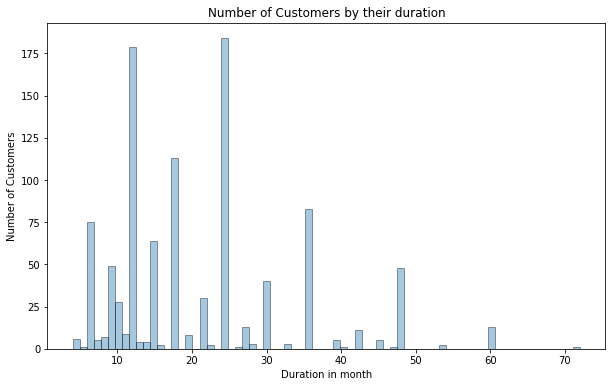

In [390]:
from matplotlib.pyplot import figure
figure(figsize=(10,6))
ax = sns.distplot(german_data['Duration in Month'], hist=True, kde=False, 
             bins=72, 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4})
ax.set_ylabel('Number of Customers')
ax.set_xlabel('Duration in month')
ax.set_title('Number of Customers by their duration')

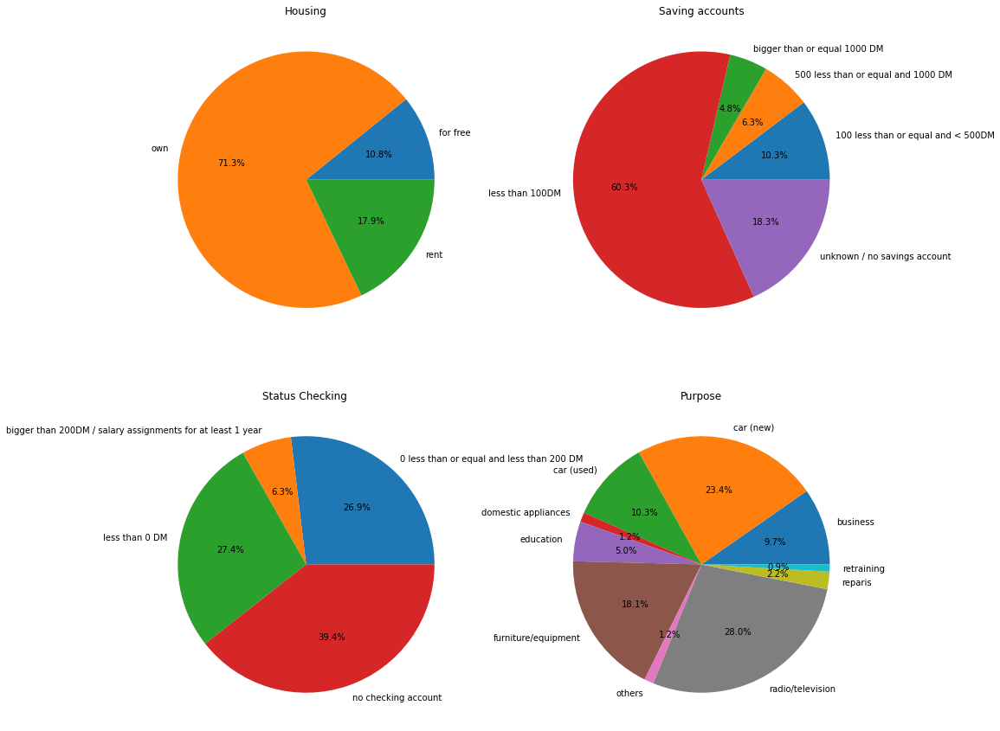

In [391]:
house_feauture = german_data.groupby('Housing')['Housing'].count()
savingaccounts_feauture = german_data.groupby('Savings Account')['Savings Account'].count()
checkingaccount_feauture = german_data.groupby('Status Checking')['Status Checking'].count()
purpose_feauture = german_data.groupby('Purpose')['Purpose'].count()

house_feauture = pd.DataFrame({'Housing':house_feauture.index, 'Count':house_feauture.values})
savingaccounts_feauture = pd.DataFrame({'Savings Account':savingaccounts_feauture.index, 'Count':savingaccounts_feauture.values})
checkingaccount_feauture = pd.DataFrame({'Status Checking':checkingaccount_feauture.index, 'Count':checkingaccount_feauture.values})
purpose_feauture = pd.DataFrame({'Purpose':purpose_feauture.index, 'Count':purpose_feauture.values})

fig = plt.figure(figsize=(15,15))

ax1 = plt.subplot2grid((2,2),(0,0))
plt.pie(house_feauture['Count'],labels = house_feauture['Housing'],autopct='%1.1f%%');
plt.title('Housing');

ax1 = plt.subplot2grid((2,2),(0,1))
plt.pie(savingaccounts_feauture['Count'],labels = savingaccounts_feauture['Savings Account'],autopct='%1.1f%%');
plt.title('Saving accounts');

ax1 = plt.subplot2grid((2,2),(1,0))
plt.pie(checkingaccount_feauture['Count'],labels = checkingaccount_feauture['Status Checking'],autopct='%1.1f%%');
plt.title('Status Checking ');

ax1 = plt.subplot2grid((2,2),(1,1))
plt.pie(purpose_feauture['Count'],labels = purpose_feauture['Purpose'],autopct='%1.1f%%');
plt.title('Purpose');

In [392]:
german_data


,Status Checking,Duration in Month,Credit History,Purpose,Credit Amount,Savings Account,Employement since,Installmentrate %,StatusSex,Other debtors,...,Property,Age in years,Otherinstallment Plans,Housing,Number existing Credits,Job,Number people liable,Telephone,Foreign Worker,Target
0,less than 0 DM,6,critical account / other credits existing (not...,radio/television,1169,unknown / no savings account,bigger than or equal 7 years,4,male : single,None,...,real estate,67,None,own,2,skilled employee /official,1,"yes, registered under the customers name",yes,0
1,0 less than or equal and less than 200 DM,48,existing credits paind back duly till now,radio/television,5951,less than 100DM,1 less than or equal and less than 4 years,2,female : divorced/separated/married,None,...,real estate,22,None,own,1,skilled employee /official,1,None,yes,1
2,no checking account,12,critical account / other credits existing (not...,education,2096,less than 100DM,4 less than and equal and less than 7 years,2,male : single,None,...,real estate,49,None,own,1,unskilled-resident,2,None,yes,0
3,less than 0 DM,42,existing credits paind back duly till now,furniture/equipment,7882,less than 100DM,4 less than and equal and less than 7 years,2,male : single,guarantor,...,if not real estate : building society savings ...,45,None,for free,1,skilled employee /official,2,None,yes,0
4,less than 0 DM,24,delay in paying off in the past,car (new),4870,less than 100DM,1 less than or equal and less than 4 years,3,male : single,None,...,unknown/no property,53,None,for free,2,skilled employee /official,2,None,yes,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,no checking account,12,existing credits paind back duly till now,furniture/equipment,1736,less than 100DM,4 less than and equal and less than 7 years,3,female : divorced/separated/married,None,...,real estate,31,None,own,1,unskilled-resident,1,None,yes,0
996,less than 0 DM,30,existing credits paind back duly till now,car (used),3857,less than 100DM,1 less than or equal and less than 4 years,4,male : divorced/separated,None,...,if not real estate : building society savings ...,40,None,own,1,management/self-employed/highly qualified empl...,1,"yes, registered under the customers name",yes,0
997,no checking account,12,existing credits paind back duly till now,radio/television,804,less than 100DM,bigger than or equal 7 years,4,male : single,None,...,"if not others options : car or other, not in s...",38,None,own,1,skilled employee /official,1,None,yes,0
998,less than 0 DM,45,existing credits paind back duly till now,radio/television,1845,less than 100DM,1 less than or equal and less than 4 years,4,male : single,None,...,unknown/no property,23,None,for free,1,skilled employee /official,1,"yes, registered under the customers name",yes,1


# Feauture Engineering

In [393]:
# since there is some correlation between credit amount and  duration in months we create a new feature
# credit amount divided by duration in months 
german_data['Credit Amount per Month'] = german_data['Credit Amount'] / german_data['Duration in Month']

# drop the duration in month feature and credit amount feature

german_data.drop(['Duration in Month', 'Credit Amount'], axis=1, inplace=True)

In [394]:
# split column StatusSex by delimiter ":"
german_data['StatusSex'] = german_data['StatusSex'].str.split(":", n=-1, expand=False)
# create new column for Status
german_data['Sex'] = german_data['StatusSex'].str.get(0)
german_data['Status'] = german_data['StatusSex'].str.get(1)

# drop column StatusSex

german_data = german_data.drop(columns="StatusSex", axis = 1)

In [395]:
# export data to csv file
german_data.to_csv('german_data_ripper.csv', index=False)

# One Hot Encoding

In [396]:
#iterate through feautures and get datatype and check if they are categorical or numerical and store them into list for one hot encoding

categorical_features = []
numerical_features = []
for i in german_data.columns:
    print(i, german_data[i].dtype)
    if german_data[i].dtype == 'object':
        print(i, german_data[i].dtype)
        categorical_features.append(i)
    else:
        print(i, german_data[i].dtype)
        numerical_features.append(i)


print(categorical_features, "Numerical:" ,numerical_features)
    

Status Checking object
Status Checking object
Credit History object
Credit History object
Purpose object
Purpose object
Savings Account object
Savings Account object
Employement since object
Employement since object
Installmentrate % int64
Installmentrate % int64
Other debtors object
Other debtors object
PresentResidence int64
PresentResidence int64
Property object
Property object
Age in years int64
Age in years int64
Otherinstallment Plans object
Otherinstallment Plans object
Housing object
Housing object
Number existing Credits int64
Number existing Credits int64
Job object
Job object
Number people liable int64
Number people liable int64
Telephone object
Telephone object
Foreign Worker object
Foreign Worker object
Target int64
Target int64
Credit Amount per Month float64
Credit Amount per Month float64
Sex object
Sex object
Status object
Status object
['Status Checking', 'Credit History', 'Purpose', 'Savings Account', 'Employement since', 'Other debtors', 'Property', 'Otherinstallmen

In [397]:
# one hot encode categorical features
german_data = pd.get_dummies(german_data, columns=categorical_features)

german_data

,Installmentrate %,PresentResidence,Age in years,Number existing Credits,Number people liable,Target,Credit Amount per Month,Status Checking_0 less than or equal and less than 200 DM,Status Checking_bigger than 200DM / salary assignments for at least 1 year,Status Checking_less than 0 DM,...,Telephone_None,"Telephone_yes, registered under the customers name",Foreign Worker_no,Foreign Worker_yes,Sex_female,Sex_male,Status_ divorced/separated,Status_ divorced/separated/married,Status_ married/windowed,Status_ single
0,4,4,67,2,1,0,194.833333,0,0,1,...,0,1,0,1,0,1,0,0,0,1
1,2,2,22,1,1,1,123.979167,1,0,0,...,1,0,0,1,1,0,0,1,0,0
2,2,3,49,1,2,0,174.666667,0,0,0,...,1,0,0,1,0,1,0,0,0,1
3,2,4,45,1,2,0,187.666667,0,0,1,...,1,0,0,1,0,1,0,0,0,1
4,3,4,53,2,2,1,202.916667,0,0,1,...,1,0,0,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,4,31,1,1,0,144.666667,0,0,0,...,1,0,0,1,1,0,0,1,0,0
996,4,4,40,1,1,0,128.566667,0,0,1,...,0,1,0,1,0,1,1,0,0,0
997,4,4,38,1,1,0,67.000000,0,0,0,...,1,0,0,1,0,1,0,0,0,1
998,4,4,23,1,1,1,41.000000,0,0,1,...,0,1,0,1,0,1,0,0,0,1


In [398]:
# still 1000 rows but 63 columns after one hot encoding
german_data.shape

(1000, 63)

In [399]:
# correlation after one hot encoding only plot significant features over 0.7 correlation

correlation_matrix(german_data)



 Positive Correlations:
 Status Checking_no checking account                                           -0.322436
Credit History_critical account / other credits existing (not at this bank)   -0.181713
Housing_own                                                                   -0.134589
Savings Account_unknown / no savings account                                  -0.129238
Property_real estate                                                          -0.119300
                                                                                 ...   
Credit History_all credits at this band paid back duly                         0.134448
Credit History_no credits tanken/all credits paid back duly                    0.144767
Savings Account_less than 100DM                                                0.161007
Status Checking_less than 0 DM                                                 0.258333
Target                                                                         1.000000
Name: T

In [400]:
correlation_matrix(german_data, drop=True)


 Positive Correlations:
 Status Checking_no checking account                                           -0.322436
Credit History_critical account / other credits existing (not at this bank)   -0.181713
Housing_own                                                                   -0.134589
Savings Account_unknown / no savings account                                  -0.129238
Property_real estate                                                          -0.119300
                                                                                 ...   
Credit History_all credits at this band paid back duly                         0.134448
Credit History_no credits tanken/all credits paid back duly                    0.144767
Savings Account_less than 100DM                                                0.161007
Status Checking_less than 0 DM                                                 0.258333
Target                                                                         1.000000
Name: T

In [401]:
# remove columns with correlation over 0.7 from the data set 
german_data

,Installmentrate %,PresentResidence,Age in years,Number existing Credits,Number people liable,Target,Credit Amount per Month,Status Checking_0 less than or equal and less than 200 DM,Status Checking_bigger than 200DM / salary assignments for at least 1 year,Status Checking_less than 0 DM,...,Housing_own,Job_management/self-employed/highly qualified employee/officer,Job_skilled employee /official,Job_unemployed/unskilled-non-resident,Job_unskilled-resident,Telephone_None,Foreign Worker_no,Sex_female,Status_ divorced/separated,Status_ married/windowed
0,4,4,67,2,1,0,194.833333,0,0,1,...,1,0,1,0,0,0,0,0,0,0
1,2,2,22,1,1,1,123.979167,1,0,0,...,1,0,1,0,0,1,0,1,0,0
2,2,3,49,1,2,0,174.666667,0,0,0,...,1,0,0,0,1,1,0,0,0,0
3,2,4,45,1,2,0,187.666667,0,0,1,...,0,0,1,0,0,1,0,0,0,0
4,3,4,53,2,2,1,202.916667,0,0,1,...,0,0,1,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,4,31,1,1,0,144.666667,0,0,0,...,1,0,0,0,1,1,0,1,0,0
996,4,4,40,1,1,0,128.566667,0,0,1,...,1,1,0,0,0,0,0,0,1,0
997,4,4,38,1,1,0,67.000000,0,0,0,...,1,0,1,0,0,1,0,0,0,0
998,4,4,23,1,1,1,41.000000,0,0,1,...,0,0,1,0,0,0,0,0,0,0


In [ ]:
german_data.to_csv('german_data_cleaned.csv', index=False)

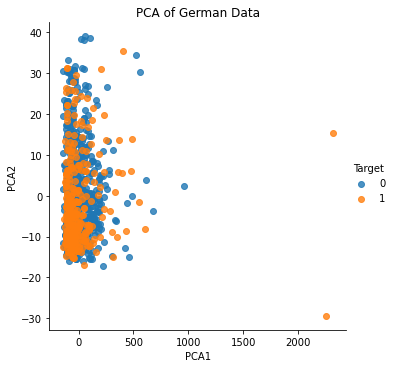

In [402]:
# use principal component analysis PCA to reduce the number of features to 2
# import PCA
from sklearn.decomposition import PCA
# create PCA object
pca = PCA(n_components=30)
# fit PCA object to data
pca.fit(german_data)
# transform data
pca_data = pca.transform(german_data)
#create dataframe of pca_data
pca_df = pd.DataFrame(pca_data, columns=['PCA1', 'PCA2',"PCA3","PCA4","PCA5","PCA6","PCA7","PCA8","PCA9","PCA10","PCA11","PCA12","PCA13","PCA14","PCA15","PCA16","PCA17","PCA18","PCA19","PCA20","PCA21","PCA22","PCA23","PCA24","PCA25","PCA26","PCA27","PCA28","PCA29","PCA30"])  


# add original data to the transformed data
pca_df = pca_df.join(german_data)
# plot the transformed data
sns.lmplot('PCA1', 'PCA2', data=pca_df, fit_reg=False, hue='Target')
plt.title('PCA of German Data')
plt.show()




In [403]:
pca_df

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,...,Housing_own,Job_management/self-employed/highly qualified employee/officer,Job_skilled employee /official,Job_unemployed/unskilled-non-resident,Job_unskilled-resident,Telephone_None,Foreign Worker_no,Sex_female,Status_ divorced/separated,Status_ married/windowed
0,27.377013,31.301115,-0.603627,0.744352,0.563501,-0.164923,0.371141,-0.495790,-0.011795,0.681682,...,1,0,1,0,0,0,0,0,0,0
1,-43.805821,-13.272442,0.939551,-0.770150,-0.696321,0.072691,0.457171,-0.326866,-0.782291,0.784293,...,1,0,1,0,0,1,0,1,0,0
2,7.082716,13.401753,0.693041,-1.017002,0.459087,0.207400,1.149195,0.368513,-0.080781,-0.663065,...,1,0,0,0,1,1,0,0,0,0
3,20.052501,9.301472,-0.595475,-1.326013,-1.008888,0.341134,-0.002283,-0.959595,0.782128,-0.155948,...,0,0,1,0,0,1,0,0,0,0
4,35.359306,17.214041,-0.758471,-0.317902,-0.287591,1.232159,-0.131000,-0.795125,0.147547,0.576020,...,0,0,1,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-23.053921,-4.353542,-0.971917,-0.485080,-0.484195,-0.165448,1.342834,0.263749,-0.042703,-0.985232,...,1,0,0,0,1,1,0,1,0,0
996,-39.087533,4.780878,-1.090286,0.545220,-0.934132,0.221904,-0.076587,0.047600,0.146317,-0.937592,...,1,1,0,0,0,0,0,0,1,0
997,-100.669209,3.241405,-1.151832,0.487719,-0.206569,-1.014509,0.152490,-0.690660,-0.843593,-0.444797,...,1,0,1,0,0,1,0,0,0,0
998,-126.779322,-11.563085,-1.760807,0.399619,-0.969590,0.297322,-0.215494,-0.602927,-0.247022,-0.057729,...,0,0,1,0,0,0,0,0,0,0


In [404]:
# create logistic regression model
from sklearn.linear_model import LogisticRegression
# import train_test_split
from sklearn.model_selection import train_test_split
# import classification_report
from sklearn.metrics import classification_report
# import fbeta_score
from sklearn.metrics import fbeta_score
# import recall score
from sklearn.metrics import recall_score

# create LogisticRegression object
logreg = LogisticRegression(random_state=42, class_weight = 'balanced')
# train test split with pca_df
X_train, X_test, y_train, y_test = train_test_split(pca_df.drop('Target', axis=1), pca_df['Target'], test_size=0.2, random_state=42)

# fit LogisticRegression object to training data
logreg.fit(X_train, y_train)
# predict on test data
y_pred = logreg.predict(X_test)
# print accuracy
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))
#print recall
print("Recall_Score:",recall_score(y_test, y_pred))
# print fbeta score with beta = 2
print('F2 score of logistic regression classifier on test set: {:.2f}'.format(fbeta_score(y_test, y_pred, beta=2)))
# print classification report
print(classification_report(y_test, y_pred))


Accuracy of logistic regression classifier on test set: 1.00
Recall_Score: 1.0
F2 score of logistic regression classifier on test set: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       141
           1       1.00      1.00      1.00        59

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200



# Ideas
- check label encoding vs one hor encoding
- hyperparamter tuning
- use shape for neuronal network
- feauture importance

- Feauture engineering?
- oversampling?


https://optuna.org/